In [1]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_formats = ['svg']
import scipy

# L01

In this notebook I will be experimenting with dynamical systems and how to model them. I will start by looking at the cylinder flow and how to approximate parameters of a known dynamical system.

## E1.7

In this exercise a fluid simulation will be made by "learning" how the fluid responds in different states. I will be looking at the cylinder flow dataset from the dmdbook.

In [2]:
data = scipy.io.loadmat("./data/CYLINDER_ALL.mat")

u_all = data["UALL"]
u_extra = data["UEXTRA"]
v_all = data["VALL"]
v_extra = data["VEXTRA"]
vort_all = data["VORTALL"]
vort_all_extra = data["VORTEXTRA"]

im_shape = (449,199)
X = u_all

The first snapshot of the u_all data is shown below.

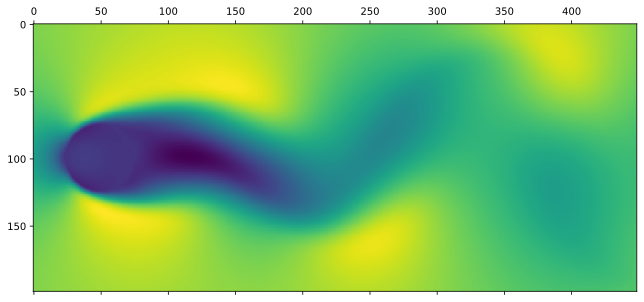

In [3]:
plt.matshow(X[:,0].reshape(im_shape).T)

### (1) SVD

In order to do dementionanity reduction a SVD analysis is carried out 

From the book: "The U matrix contains eigenflow fields and the ΣV∗ represents the amplitudes of these eigenflows as the flow evolves in time."

In [4]:
U, sigma, Vt = scipy.linalg.svd(X,full_matrices=False)

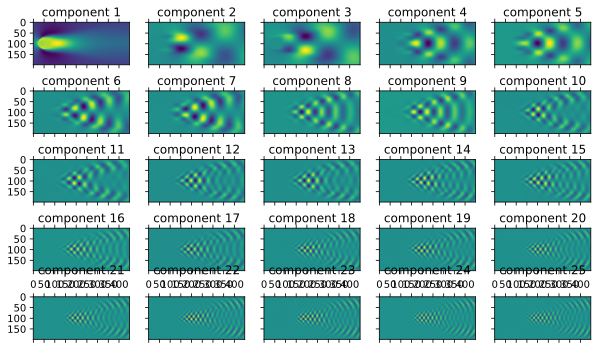

In [5]:
fig, axs = plt.subplots(5,5, figsize=(10,6), sharex=True, sharey=True)

axs = axs.flatten()

for i, ax in enumerate(axs):
    ax.matshow(U[:,i].reshape(im_shape).T)
    ax.set_title(f"component {i+1}")

The above figure shows the first 25 eigen modes. It can be seen that the first component captures the mean values and the rest captures how the "tail" moves.

To do dimensionality reduction the singular values are plotted:

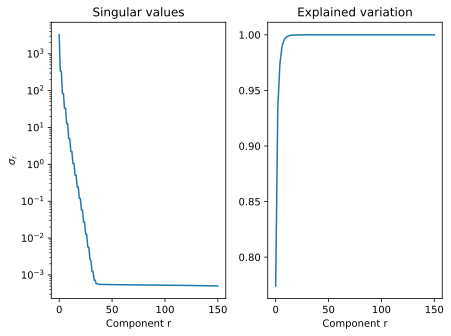

In [6]:

explained_variance = np.cumsum(sigma) / np.sum(sigma)

fig, axs = plt.subplots(1,2)

axs[0].semilogy(sigma)
axs[0].set_title("Singular values")
axs[0].set_xlabel("Component r")
axs[0].set_ylabel("$\sigma_r$")

axs[1].plot(explained_variance)
axs[1].set_title("Explained variation")
axs[1].set_xlabel("Component r")

plt.tight_layout()
plt.show()

It can be seen here that the power of the singular values falls quickly. The graph flattens out at ~50 indicating that 50 SVD modes will capture almost all the variance of the system.

### (2) Approximation of the $X$ matrix

The code below finds how many columns are needed to approximate the $X$ matrix to capture x% of the variance. 

In [7]:
print(np.argmax(explained_variance[explained_variance < 0.9]))
print(np.argmax(explained_variance[explained_variance < 0.99]))
print(np.argmax(explained_variance[explained_variance < 0.999]))

1
6
11


- r=1 to reconstruct the image with 90% of the flow energy
- r=6 to reconstruct the image with 99% of the flow energy
- r=11 to reconstruct the image with 99% of the flow energy

Below the reconstructed first snapshot are plotted. It can be seen that with r=1 only captures the mean values of the states even though is accounts for 90% of the energy. Therefore, more modes are needed in order to capture the real snapshot.

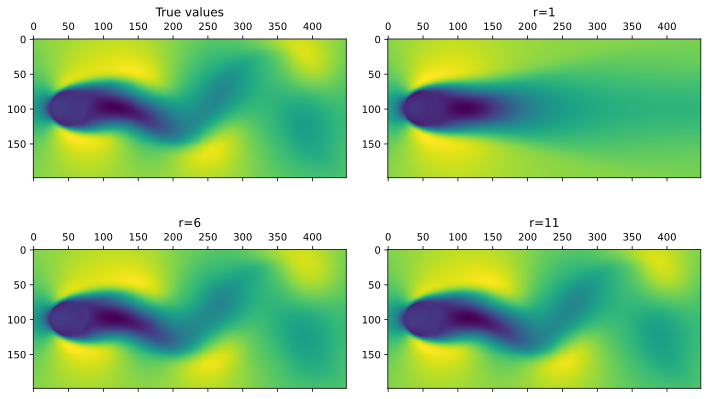

In [8]:
fig, axs = plt.subplots(2,2, figsize=(10,6))
plt.tight_layout()
rs = [1,6,11]

axs[0,0].matshow(X[:,0].reshape(im_shape).T)
axs[0,0].set_title(f"True values")
for i, r in enumerate(rs):
    ii = i + 1
    U_approx = U[:,0:r]
    x = data["UALL"][:,0]
    x_approx = (U_approx @ (U_approx.T @ x))
    axs[ii // 2, ii % 2].matshow(x_approx.reshape(im_shape).T)
    axs[ii // 2, ii % 2].set_title(f"r={r}")

plt.show()

### (3) Approximating the X matrix with r-number of columns of the $W$ matrix

Below I use r=10 modes in order to reconstruct the snapshots. I first encode all the snapshots using:

$$W = \tilde{\Sigma} \tilde{V}^*$$

where  $\tilde{\Sigma}$ and $\tilde{V}^*$ are the truncated SVD matrices with r-number of columns.

I then reconstruct the snapshot by using:

$ X \approx U W$

RMSE: 0.0016650462747829743
min: -0.013984402872771473
max: 0.014239134244507734


Text(0.5, 1.0, 'Difference')

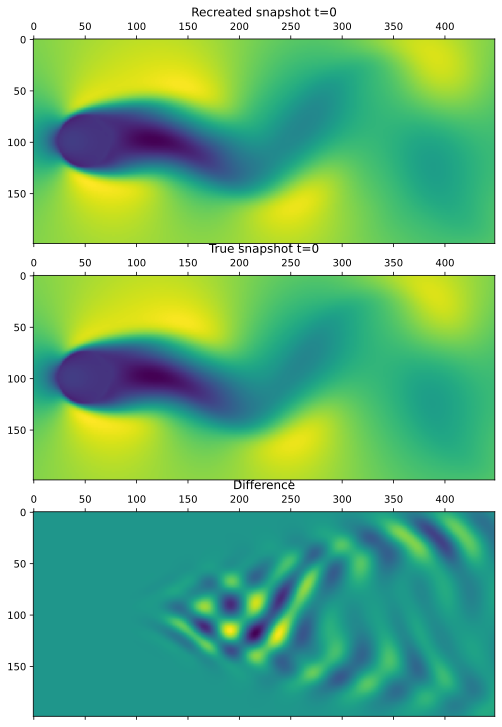

In [9]:
r = 10
Sigma_r = np.diag(sigma)
Vt_r = Vt[0:r,:]
W = np.diag(sigma[0:r]) @ Vt_r
U_r = U[:,0:r]


print(f"RMSE: {np.sqrt(np.mean((U_r@W - X)**2))}")
print(f"min: {np.min(U_r@W - X)}")
print(f"max: {np.max(U_r@W - X)}")

fig, axs = plt.subplots(3,1,figsize=(10,10))
plt.tight_layout()
axs[0].matshow((U_r@W[:,0]).reshape(im_shape).T)
axs[0].set_title("Recreated snapshot t=0")
axs[1].matshow(X[:,0].reshape(im_shape).T)
axs[1].set_title("True snapshot t=0")
axs[2].matshow((U_r@W[:,0] - X[:,0]).reshape(im_shape).T)
axs[2].set_title("Difference")



With r=10 I get good reconstruction results with a RMSE of 0.00166.

### DMD analysis

I will now try to predict the next snapshot based on the current state of the system. I will do this with a linear DMD model.

The dynamical system can be described with the columns of W:
$$
w_{k+1} = A w_k
$$

I will consider the $u$-velocity component as represented by the $\mathbf{w}_k$-vectors:

$$W' = A W$$
This can be written as:
```python
W[:,1:] = A@W[:,:-1]
```
The matrix $A$ can be found by the pseudo-inverse of $W$:

$$W = U \Sigma V^T$$
$$W' = A U \Sigma V^T$$
$$W' V \Sigma^{-1} U^T = A$$

In [10]:
U_w, Sigma_w, Vt_w = np.linalg.svd(W[:,:-1], full_matrices=False)

In [11]:
A = (((W[:,1:] @ Vt_w.T) @ np.linalg.inv(np.diag(Sigma_w))) @ U_w.T)

Text(0, 0.5, 'Imaginary')

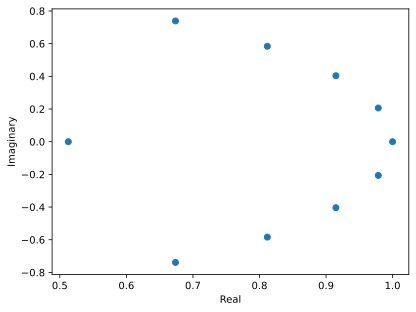

In [12]:
A_eigenvalues = np.linalg.eigvals(A)

x = [x.real for x in A_eigenvalues]
y = [y.imag for y in A_eigenvalues]
plt.scatter(x,y)
plt.xlabel("Real")
plt.ylabel("Imaginary")

The plot above shows the eigenvalues of the $A$ matrix. It shows that the eigenvalues lies on a circle which indicates that the system is stable.

### (4) Use of $A$ to predict the state of the fluid
In this step I use the $A$ matrix to predict future model states based on the first snapshot.

The equation used is:
$$w_k = A^{k} w_0$$

In [13]:
w_k = W[:,0]
x_reconstructed_list = []
for i in range(X.shape[1]):
    w_k = A @ w_k
    x_reconstructed = U_r @ w_k
    x_reconstructed_list.append(x_reconstructed)

In [14]:
from matplotlib import animation
from IPython.display import HTML, display

fig, axs = plt.subplots(3,1, figsize=(5,6))
fig.set_tight_layout(True)

def animate(i):
    k = i
    x_true = X[:,k]
    axs[0].matshow(x_reconstructed_list[i].reshape(im_shape).T)
    axs[0].set_title("Predicted")
    axs[1].matshow(x_true.reshape(im_shape).T)
    axs[1].set_title("True")
    axs[2].matshow((x_true - x_reconstructed_list[i]).reshape(im_shape).T)
    axs[2].set_title("Difference")

ani = animation.FuncAnimation(fig, animate, repeat=True, frames=X.shape[1], interval=30)

output = HTML(ani.to_jshtml())
display(output)
plt.close()

Animation size has reached 21011668 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


The results shows that the flow can be approximated in a SVD subspace and in this subspace predicted into the future using the DMD method.

## X01.1

In this experiment I will try to estimate the parameters of a known SIR model, only based on the output from a simulation.

### The model

I use the SIR model as shown below to describe one time step in an epidemic:

$$\frac{dS}{dt} = - \beta s i$$

$$\frac{di}{dt} = \beta s i - \gamma i$$

$$\frac{dr}{dt} = \gamma i$$

I use these equations to simulate a system with $a=0.001$ and $b=0.01$:

In [15]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import solve_ivp

def sir_step(t, state, parameters):
    beta, gamma = parameters
    s, i, r = state
    beta, gamma

    ds = -beta * s * i
    di = beta * s * i - gamma * i
    dr = gamma * i

    new_state = np.array([ds, di, dr])

    return new_state

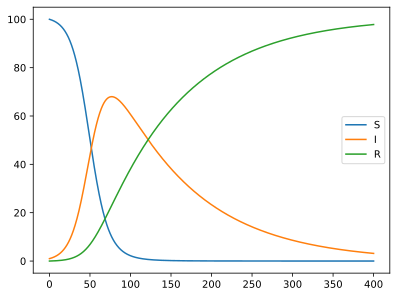

In [16]:
initial_state = np.array([100, 1, 0])
parameters = np.array([0.001, 0.01])
t_span = (0,400)
t_eval = np.linspace(t_span[0], t_span[1], 1000)

sol = solve_ivp(lambda t,y: sir_step(t, y, parameters), t_span, initial_state, t_eval=t_eval)

plt.figure()
plt.plot(sol.t, sol.y[0], label="S")
plt.plot(sol.t, sol.y[1], label="I")
plt.plot(sol.t, sol.y[2], label="R")
plt.legend()

### Results

In [17]:
d_approx = (sol.y[:,1:] - sol.y[:,:-1]) / (sol.t[1:] - sol.t[:-1])

s_approx = sol.y[0,:-1]
i_approx = sol.y[1,:-1]
r_approx = sol.y[2,:-1]

To solve this system i place the values in a block matrix:

$$b = Ax$$


$$

b = \begin{bmatrix}
\begin{bmatrix}
\frac{dS}{dt}
\end{bmatrix} \\
\vdots \\
\begin{bmatrix}
\frac{dI}{dt}
\end{bmatrix} \\
\vdots \\
\begin{bmatrix}
\frac{dR}{dt}
\end{bmatrix} \\
\end{bmatrix} = 

\begin{bmatrix}
\begin{bmatrix}
- SI & 0 \\
\end{bmatrix} \\
\vdots \\
\begin{bmatrix}
SI & -\gamma I \\
\end{bmatrix} \\
\vdots \\
\begin{bmatrix}
0 & \gamma I \\
\end{bmatrix} \\
\end{bmatrix}

\begin{bmatrix}
\beta \\
\gamma
\end{bmatrix}

$$

To approximate the systems parameters i solve the linear system for $\alpha$ and $\beta$ with the pusdoinverse found via the SVD.

In [18]:
A1 = np.concatenate((-s_approx*i_approx, s_approx*i_approx, np.zeros(999)))
A2 = np.concatenate((np.zeros(999), -i_approx, i_approx))

A = np.column_stack((A1,A2))
b = d_approx.flatten()

U, sigma, Vt = np.linalg.svd(A, full_matrices=False)
Sigma = np.diag(sigma)

x = (Vt.T @ np.linalg.inv(Sigma)) @ (U.T @ b)
print(f"Estimated parameters: {x}")
print(f"True parameters: {parameters}")

Estimated parameters: [0.00100072 0.01002429]
True parameters: [0.001 0.01 ]


The results show that the parameters of the system can be approximated using the pusdoinverse.